In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

import plotly.offline as pyo
import plotly.graph_objs as go
import plotly.graph_objects as go
# Set notebook mode to work in offline
pyo.init_notebook_mode()
import plotly.express as px
from plotly.subplots import make_subplots

import re

from wordcloud import WordCloud

from collections import Counter

import nltk

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
# For Google Colab

def configure_plotly_browser_state():
  import IPython
  display(IPython.core.display.HTML('''
        <script src="/static/components/requirejs/require.js"></script>
        <script>
          requirejs.config({
            paths: {
              base: '/static/base',
              plotly: 'https://cdn.plot.ly/plotly-latest.min.js?noext',
            },
          });
        </script>
        '''))

In [ ]:
PATH = '/content/'
FILE = f'{PATH}stopwords.xlsx'

X0 = 'Final Data'
X1 = 'Short description'
X2 = 'Description'
X3 = 'Caller'
Y = 'Assignment group'

X4 = 'Word Count'
X5 = 'Short Word Count'

In [ ]:
data = pd.read_excel(FILE, engine='openpyxl')
data.head()

,Unnamed: 0,Short description,Description,Caller,Assignment group
0,0,login issue,verified user details employee manager checked...,spxjnwir pjlcoqds,GRP_0
1,1,outlook,received hello team meetings skype meetings et...,hmjdrvpb komuaywn,GRP_0
2,2,nt log vpn,received hi log vpn best,eylqgodm ybqkwiam,GRP_0
3,3,unable access hr tool page,unable access hr tool page,xbkucsvz gcpydteq,GRP_0
4,4,skype error,skype error,owlgqjme qhcozdfx,GRP_0


In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8492 entries, 0 to 8491
Data columns (total 5 columns):
 #   Column             Non-Null Count  Dtype 
---  ------             --------------  ----- 
 0   Unnamed: 0         8492 non-null   int64 
 1   Short description  8478 non-null   object
 2   Description        8425 non-null   object
 3   Caller             8492 non-null   object
 4   Assignment group   8492 non-null   object
dtypes: int64(1), object(4)
memory usage: 331.8+ KB


## Working with duplication of data, row wise as well as column wise

### Row wise duplication
Find all duplicate checking with X1, X2 and Y have same.

In [ ]:
duplicate = data[data.duplicated([X1, X2, Y])]

In [ ]:
duplicate.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1769 entries, 15 to 8481
Data columns (total 5 columns):
 #   Column             Non-Null Count  Dtype 
---  ------             --------------  ----- 
 0   Unnamed: 0         1769 non-null   int64 
 1   Short description  1763 non-null   object
 2   Description        1721 non-null   object
 3   Caller             1769 non-null   object
 4   Assignment group   1769 non-null   object
dtypes: int64(1), object(4)
memory usage: 82.9+ KB


In [ ]:
duplicate.groupby(Y).size()

Assignment group
GRP_0     866
GRP_1       3
GRP_10     58
GRP_12     15
GRP_13      3
GRP_15      1
GRP_17     44
GRP_18      3
GRP_19      1
GRP_21      1
GRP_24     58
GRP_31      1
GRP_39      3
GRP_4       5
GRP_41      1
GRP_45      6
GRP_47      3
GRP_5      77
GRP_6      99
GRP_60      9
GRP_7       1
GRP_8     339
GRP_9     172
dtype: int64

In [ ]:
duplicate.to_excel('duplicate_cleaned_translated_ansi_encoded_utf8_decoded_v4.xlsx')

In [ ]:
# data.drop(duplicate.index, inplace=True)

There are still data where X1 and X2 are same but target variable Y is different. Need to see what needs to be done for that. There are 16 such rows which has X1 and X2 same but Y different

In [ ]:
confused = data[data.duplicated([X1, X2])]

In [ ]:
def get_potential_wrong_labelled_data(short_desc):
    if str(confused[X1]).find(str(short_desc)) != -1:
        return True
    return False

potential_wrong_data = data[data.apply(lambda x: get_potential_wrong_labelled_data(x[X1]), axis=1)]

In [ ]:
potential_wrong_data.sort_values([X1, X2])

,Unnamed: 0,Short description,Description,Caller,Assignment group
7781,7781,HostName,unable reach destination server offline,ctvaejbo mjcerqwo,GRP_12
8119,8119,abended job job scheduler bkwin HostName inc,received abended job job scheduler bkwin HostN...,ZkBogxib QsEJzdZO,GRP_5
8307,8307,abended job job scheduler bkwin HostName inc,received abended job job scheduler bkwin HostN...,ZkBogxib QsEJzdZO,GRP_8
8458,8458,abended job job scheduler bkwin HostName inc,received abended job job scheduler bkwin HostN...,ZkBogxib QsEJzdZO,GRP_8
3576,3576,account,hello unable login bcd travel creation passwor...,anuxbyzg bvsqcjkw,GRP_0
...,...,...,...,...,...
8033,8033,update inplant,update inplant,rbozivdq gmlhrtvp,GRP_0
8327,8327,update inplant,update inplant,rbozivdq gmlhrtvp,GRP_0
3057,3057,update ticket,dfgtyon stasrty language browser microsoft int...,rbozivdq gmlhrtvp,GRP_0
2919,2919,update ticket,update ticket,rbozivdq gmlhrtvp,GRP_0


In [ ]:
potential_wrong_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 699 entries, 9 to 8481
Data columns (total 5 columns):
 #   Column             Non-Null Count  Dtype 
---  ------             --------------  ----- 
 0   Unnamed: 0         699 non-null    int64 
 1   Short description  699 non-null    object
 2   Description        699 non-null    object
 3   Caller             699 non-null    object
 4   Assignment group   699 non-null    object
dtypes: int64(1), object(4)
memory usage: 32.8+ KB


In [ ]:
potential_wrong_data.groupby(Y).size()

Assignment group
GRP_0     187
GRP_10     22
GRP_12      9
GRP_13      4
GRP_14      1
GRP_18      3
GRP_19      1
GRP_29      1
GRP_31      1
GRP_34      1
GRP_44      1
GRP_45      6
GRP_47      3
GRP_5      23
GRP_57      1
GRP_6      61
GRP_60      4
GRP_72      1
GRP_8     216
GRP_9     153
dtype: int64

### Column wise duplication

This is required to check and as ultimately we are going to merge both of the columns in the end before feeding to model for training. This will help in removing unecessary redundancy of data which impacts the outcome. There are 3592 such rows

In [ ]:
redundant_desc = data[data.apply(lambda x: str(x[X2]).find(str(x[X1])) != -1, axis=1)]
redundant_desc

,Unnamed: 0,Short description,Description,Caller,Assignment group
0,0,login issue,verified user details employee manager checked...,spxjnwir pjlcoqds,GRP_0
1,1,outlook,received hello team meetings skype meetings et...,hmjdrvpb komuaywn,GRP_0
3,3,unable access hr tool page,unable access hr tool page,xbkucsvz gcpydteq,GRP_0
4,4,skype error,skype error,owlgqjme qhcozdfx,GRP_0
5,5,unable log engineering tool skype,unable log engineering tool skype,eflahbxn ltdgrvkz,GRP_0
...,...,...,...,...,...
8484,8484,hr tool etime option visitble,hr tool etime option visitble,tmopbken ibzougsd,GRP_0
8486,8486,tablet needs reimaged multiple issues crm wifi...,tablet needs reimaged multiple issues crm wifi...,cpmaidhj elbaqmtp,GRP_3
8488,8488,telephony software issue,telephony software issue,rbozivdq gmlhrtvp,GRP_0
8489,8489,vip windows password reset tifpdchb pedxruyf,vip windows password reset tifpdchb pedxruyf,oybwdsgx oxyhwrfz,GRP_0


In [ ]:
def merge_data(short_desc, long_desc):
    if str(long_desc).find(str(short_desc)) != -1:
        return str(long_desc).lower()
    else:
        return (str(short_desc) + " " + str(long_desc)).lower()


data[X0] = data.apply(lambda x: merge_data(x[X1], x[X2]), axis=1)
data.head()

,Unnamed: 0,Short description,Description,Caller,Assignment group,Final Data
0,0,login issue,verified user details employee manager checked...,spxjnwir pjlcoqds,GRP_0,verified user details employee manager checked...
1,1,outlook,received hello team meetings skype meetings et...,hmjdrvpb komuaywn,GRP_0,received hello team meetings skype meetings et...
2,2,nt log vpn,received hi log vpn best,eylqgodm ybqkwiam,GRP_0,nt log vpn received hi log vpn best
3,3,unable access hr tool page,unable access hr tool page,xbkucsvz gcpydteq,GRP_0,unable access hr tool page
4,4,skype error,skype error,owlgqjme qhcozdfx,GRP_0,skype error


In [ ]:
data.isna().sum()

Unnamed: 0            0
Short description    14
Description          67
Caller                0
Assignment group      0
Final Data            0
dtype: int64

Since we don't have any null in final data, it is not required to eliminate any rows completely.

In [ ]:
data.reset_index(inplace=True)

## Add count of words

This is required to analyse what should be the length our model should take to understand it's group

In [ ]:
data[X4] = data[X0].str.split(" ").apply(lambda x: len(x))
data[X5] = data[X1].astype(str).str.split(" ").apply(lambda x: len(x))

In [ ]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8492 entries, 0 to 8491
Data columns (total 9 columns):
 #   Column             Non-Null Count  Dtype 
---  ------             --------------  ----- 
 0   index              8492 non-null   int64 
 1   Unnamed: 0         8492 non-null   int64 
 2   Short description  8478 non-null   object
 3   Description        8425 non-null   object
 4   Caller             8492 non-null   object
 5   Assignment group   8492 non-null   object
 6   Final Data         8492 non-null   object
 7   Word Count         8492 non-null   int64 
 8   Short Word Count   8492 non-null   int64 
dtypes: int64(4), object(5)
memory usage: 597.2+ KB


## Target column analysis

Need to find how many classifications are there in the data since we are going to classify into this classes.

* Requires to check biasness in data provided, this will help in finding the approach on how to move forward

In [ ]:
data[Y].unique()

array(['GRP_0', 'GRP_1', 'GRP_3', 'GRP_4', 'GRP_5', 'GRP_6', 'GRP_7',
       'GRP_8', 'GRP_9', 'GRP_10', 'GRP_11', 'GRP_12', 'GRP_13', 'GRP_14',
       'GRP_15', 'GRP_16', 'GRP_17', 'GRP_18', 'GRP_19', 'GRP_2',
       'GRP_20', 'GRP_21', 'GRP_22', 'GRP_23', 'GRP_24', 'GRP_25',
       'GRP_26', 'GRP_27', 'GRP_28', 'GRP_29', 'GRP_30', 'GRP_31',
       'GRP_33', 'GRP_34', 'GRP_35', 'GRP_36', 'GRP_37', 'GRP_38',
       'GRP_39', 'GRP_40', 'GRP_41', 'GRP_42', 'GRP_43', 'GRP_44',
       'GRP_45', 'GRP_46', 'GRP_47', 'GRP_48', 'GRP_49', 'GRP_50',
       'GRP_51', 'GRP_52', 'GRP_53', 'GRP_54', 'GRP_55', 'GRP_56',
       'GRP_57', 'GRP_58', 'GRP_59', 'GRP_60', 'GRP_61', 'GRP_32',
       'GRP_62', 'GRP_63', 'GRP_64', 'GRP_65', 'GRP_66', 'GRP_67',
       'GRP_68', 'GRP_69', 'GRP_70', 'GRP_71', 'GRP_72', 'GRP_73'],
      dtype=object)

In [ ]:
configure_plotly_browser_state()

agg_data = data.groupby(Y).size().reset_index(name = 'count')
fig = px.pie(agg_data, values='count', names=Y, title='Ticket Assignment')
fig.show()

In [ ]:
configure_plotly_browser_state()

fig = px.pie(agg_data[agg_data[Y]!='GRP_0'], values='count', names=Y, title='Ticket Assignment non GRP_0')
fig.show()

In [ ]:
configure_plotly_browser_state()

fig = px.histogram(data, x=Y, template='plotly_white', title='Tickets assigned to the group')
fig.update_xaxes(categoryorder='total descending').update_yaxes(title='Number of tickets')
fig.show()

In [ ]:
configure_plotly_browser_state()

fig = px.histogram(data, x=X4, template='plotly_white', title='Words in the description')
fig.update_xaxes(categoryorder='total descending', title='Number of words (clipped at 1000 words)').update_yaxes(title='Number of complaints')
fig.show()

In [ ]:
configure_plotly_browser_state()

fig = px.histogram(data, x=X5, template='plotly_white', title='Words in the short description')
fig.update_xaxes(categoryorder='total descending', title='Number of words (clipped at 1000 words)').update_yaxes(title='Number of complaints')
fig.show()

We have in total 74 groups in 7909 rows of data, and out of that 43% of data is just assigned to *GRP_0* which is clearly biased towards it. Few of the groups are so negligible that don't even have more than 10 of such rows. It would be better to split data into data with only *GRP_0* and *non-GRP_0* to make analysis much more precise

In [ ]:
# def  clean_text(df, text_field, new_text_field_name):
#     df[new_text_field_name] = df[text_field].str.lower()
#     df[new_text_field_name] = df[new_text_field_name].apply(lambda elem: re.sub(r"(@[A-Za-z0-9]+)|([^0-9A-Za-z \t])|(\w+:\/\/\S+)|^rt|http.+?", "", elem))  
#     # remove numbers
#     df[new_text_field_name] = df[new_text_field_name].apply(lambda elem: re.sub(r"\d+", "", elem))
#     return df

In [ ]:
data_non_0 = data[data[Y] != 'GRP_0']
data_0 = data[data[Y] == 'GRP_0']

In [ ]:
configure_plotly_browser_state()

fig = make_subplots(rows=3, cols=1)
fig.add_trace(go.Box(x=data[X4], name='Desc All'), row=1, col=1)
fig.add_trace(go.Box(x=data_0[X4], name='Desc GRP0'), row=2, col=1)
fig.add_trace(go.Box(x=data_non_0[X4], name='Desc Non GRP0'), row=3, col=1)

fig.update_traces(showlegend=False)
fig.update_layout({
    'width':1024,
    'height':600,
    'title':'Description total words'
})
fig.show()

In [ ]:
configure_plotly_browser_state()

fig = make_subplots(rows=3, cols=1)
fig.add_trace(go.Box(x=data[X5], name='Short Desc All'), row=1, col=1)
fig.add_trace(go.Box(x=data_0[X5], name='Short Desc GRP0'), row=2, col=1)
fig.add_trace(go.Box(x=data_non_0[X5], name='Short Desc Non GRP0'), row=3, col=1)

fig.update_traces(showlegend=False)
fig.update_layout({
    'width':1024,
    'height':600,
    'title':'Short Description total words'
})
fig.show()

In [ ]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
index,8492.0,4245.500000,2451.573576,0.0,2122.75,4245.5,6368.25,8491.0
Unnamed: 0,8492.0,4245.500000,2451.573576,0.0,2122.75,4245.5,6368.25,8491.0
Word Count,8492.0,18.156500,41.855103,1.0,5.00,9.0,19.00,1062.0
Short Word Count,8492.0,4.962789,2.570276,1.0,3.00,4.0,6.00,19.0


In [ ]:
data_0.describe().T

,count,mean,std,min,25%,50%,75%,max
index,3969.0,4185.855631,2472.958391,0.0,2048.0,4193.0,6326.0,8489.0
Unnamed: 0,3969.0,4185.855631,2472.958391,0.0,2048.0,4193.0,6326.0,8489.0
Word Count,3969.0,11.879315,16.042135,1.0,3.0,6.0,16.0,262.0
Short Word Count,3969.0,4.040816,2.042479,1.0,3.0,4.0,5.0,19.0


In [ ]:
data_non_0.describe().T

,count,mean,std,min,25%,50%,75%,max
index,4523.0,4297.838824,2431.721883,6.0,2192.0,4299.0,6401.5,8491.0
Unnamed: 0,4523.0,4297.838824,2431.721883,6.0,2192.0,4299.0,6401.5,8491.0
Word Count,4523.0,23.664824,54.760473,1.0,6.0,11.0,23.0,1062.0
Short Word Count,4523.0,5.771833,2.709858,1.0,4.0,5.0,7.0,18.0


From above **boxplot** *&* **description** it is clear that data from the group **GRP_0** has word count much less than any other group. This will be improved or some data loss will be there when gibberish data is cleansed from the given data

In [ ]:
data[data[X4] <= 5]

,index,Unnamed: 0,Short description,Description,Caller,Assignment group,Final Data,Word Count
3,3,3,unable access hr tool page,unable access hr tool page,xbkucsvz gcpydteq,GRP_0,unable access hr tool page,5
4,4,4,skype error,skype error,owlgqjme qhcozdfx,GRP_0,skype error,2
5,5,5,unable log engineering tool skype,unable log engineering tool skype,eflahbxn ltdgrvkz,GRP_0,unable log engineering tool skype,5
8,8,8,unable disable add ins outlook,unable disable add ins outlook,mdbegvct dbvichlg,GRP_0,unable disable add ins outlook,5
9,9,9,ticket update inplant,ticket update inplant,fumkcsji sarmtlhy,GRP_0,ticket update inplant,3
...,...,...,...,...,...,...,...,...
8477,8477,8477,ticket update inc user,ticket update inc user,fumkcsji sarmtlhy,GRP_0,ticket update inc user,4
8478,8478,8478,ticket update ticket,ticket update ticket,fumkcsji sarmtlhy,GRP_0,ticket update ticket,3
8481,8481,8481,account locked,account locked,sdvlxbfe ptnahjkw,GRP_0,account locked,2
8484,8484,8484,hr tool etime option visitble,hr tool etime option visitble,tmopbken ibzougsd,GRP_0,hr tool etime option visitble,5


In [ ]:
cloud = WordCloud(random_state=1, collocations=False)

In [ ]:
def plot_cloud(wordcloud_data):
    wordcloud = cloud.generate(wordcloud_data)
    # Set figure size
    plt.figure(figsize=(30, 20))
    # Display image
    plt.imshow(wordcloud, interpolation='bilinear') 
    # No axis details
    plt.axis("off")
    plt.show()

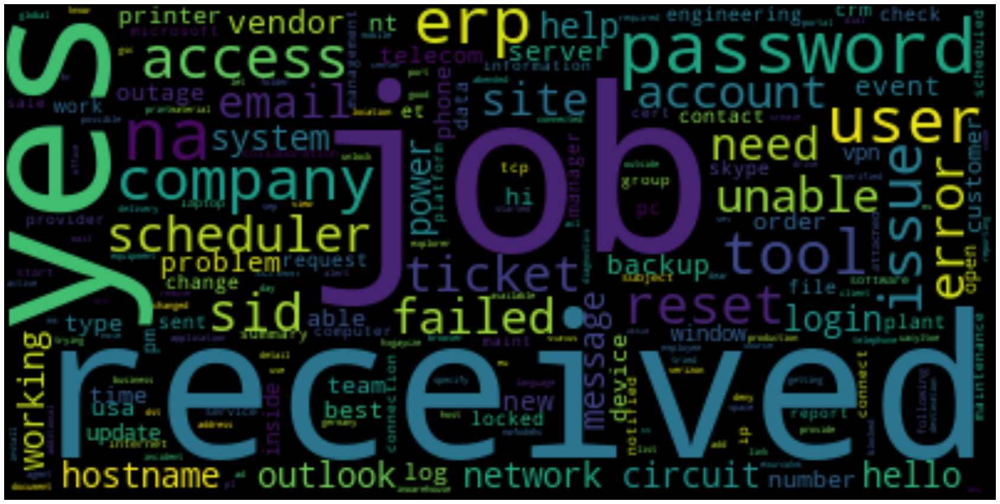

In [ ]:
plot_cloud(' '.join(data[X0]))

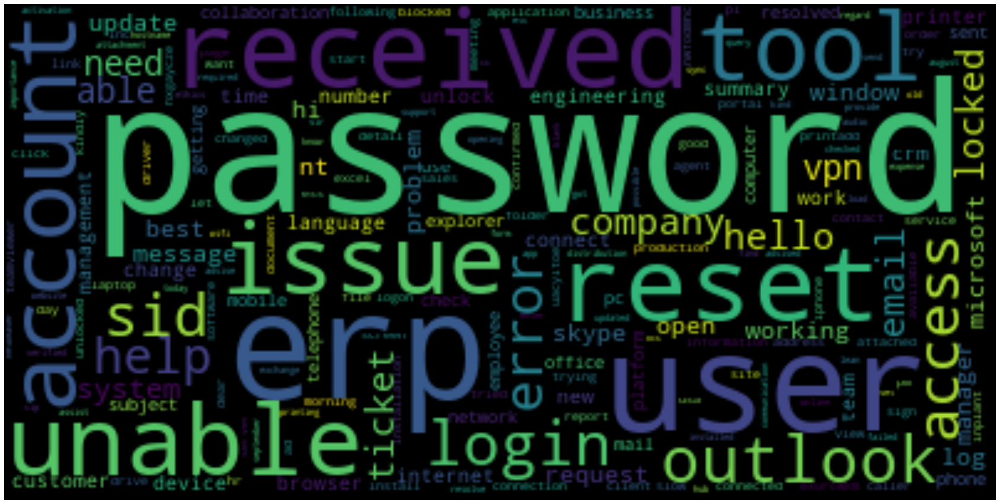

In [ ]:
plot_cloud(' '.join(data_0[X0]))

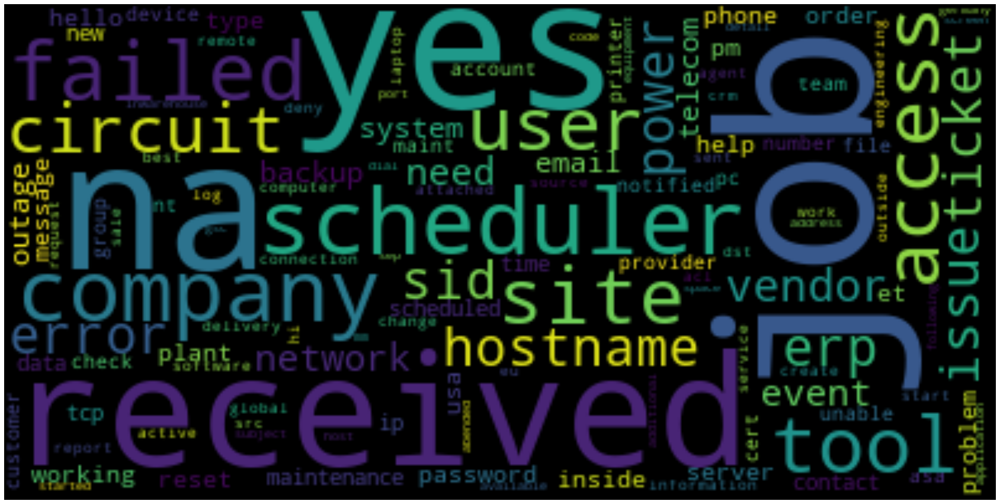

In [ ]:
plot_cloud(' '.join(data_non_0[X0]))

All these word clouds are useful to detect some pattern of data having words like ***\_x000d\_*** needs to be removed. Word clouds can be used again and again to detect such data to clean data.

### Types of words used in particular group

Apart from finding the count of words per group, it is crucial to check what kind of words are used most in particular group. Some of the words can be specific to the group and can help to identify their group based on such keywords used

In [ ]:
# Function to find common words for each defined category
def find_common_words_by_category(categories, N):
    common_words = {}
    for category in categories:
        category_text = [text for text in data[data[Y] == category][X0]]
        
        category_text = ' '.join(category_text).split()
        category_counter = Counter(category_text)
        cat_dict = {}
        for word in category_counter.most_common(N):
            cat_dict[word[0]] = word[1]
        common_words[category] = cat_dict
        
        word_statement = f"{category} has {common_words[category]}"
    return common_words

In [ ]:
top_words = find_common_words_by_category(data[Y].unique(), 100)

In [ ]:
def plot_cloud_freq(wordcloud_data):
    total_categories = len(wordcloud_data)
    fig = plt.figure(figsize=(20, 200))
    
    i = 0
    for category in wordcloud_data:
        wordcloud = cloud.generate_from_frequencies(wordcloud_data[category])
        ax= plt.subplot(int(total_categories / 2), 2, i + 1)
        im=ax.imshow(wordcloud, interpolation='bilinear')
        plt.axis('off')
        plt.title(category, fontsize=16)
        i = i + 1
    plt.show()

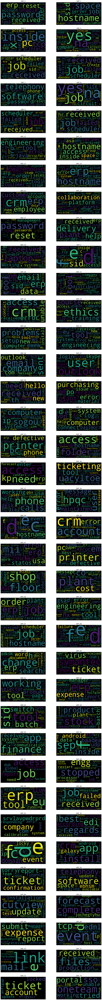

In [ ]:
plot_cloud_freq(top_words)

Generating bigrams for further analysis

In [ ]:
def get_bigram(texts):
    bigrams = list(nltk.bigrams(texts))
    bigrams_counter = Counter(bigrams)

    bigram_list = []
    for bigram in bigrams_counter.most_common():
        words = str(list(bigram[0]))
        count = bigram[1]
        bigram_list.append([words, count])

    columns = ['bigram', 'count']
    bigram_series = pd.DataFrame(bigram_list, columns=columns)
    return bigram_series
               
bigram_data = get_bigram(' '.join(data[X0]).split())
bigram_data_0 = get_bigram(' '.join(data_0[X0]).split())
bigram_data_non_0 = get_bigram(' '.join(data_non_0[X0]).split())

In [ ]:
bigram_data_short = get_bigram(' '.join(data[X1].astype(str)).split())
bigram_data_0_short = get_bigram(' '.join(data_0[X1].astype(str)).split())
bigram_data_non_0_short = get_bigram(' '.join(data_non_0[X1].astype(str)).split())

In [ ]:
bigram_data_short.head()

,bigram,count
0,"['job', 'scheduler']",959
1,"['failed', 'job']",805
2,"['job', 'Job']",483
3,"['Job', 'failed']",451
4,"['password', 'reset']",428


In [ ]:
def bar_graph_bigram(data, title):
    configure_plotly_browser_state()

    fig = px.bar(data[:20], x='bigram', y='count', title=title, template='plotly_white', labels={'ngram': 'Bigram', 'count': 'Count'})
    fig.show()

In [ ]:
bar_graph_bigram(bigram_data, "Counts of top bigrams")

In [ ]:
bar_graph_bigram(bigram_data_0, "Counts of top bigrams for GRP_0")

In [ ]:
bar_graph_bigram(bigram_data_non_0, "Counts of top bigrams for non GRP_0")

In [ ]:
bar_graph_bigram(bigram_data_short, "Counts of top bigrams for Short Desc")

In [ ]:
bar_graph_bigram(bigram_data_0_short, "Counts of top bigrams for Short Desc for GRP_0")

In [ ]:
bar_graph_bigram(bigram_data_non_0_short, "Counts of top bigrams for Short Desc for non GRP_0")

Removing unwanted set of words like yes, na, received also greeting words like hi, hello would be much beneficial as they create no sense what so ever

In [ ]:
text = [[text for text in doc.split()] for doc in data[X0]]
text_0 = [[text for text in doc.split()] for doc in data_0[X0]]
text_non_0 = [[text for text in doc.split()] for doc in data_non_0[X0]]

text_short = [[text for text in doc.split()] for doc in data[X1].astype(str)]
text_0_short = [[text for text in doc.split()] for doc in data_0[X1].astype(str)]
text_non_0_short = [[text for text in doc.split()] for doc in data_non_0[X1].astype(str)]

In [ ]:
import gensim
from gensim import corpora
from gensim.utils import simple_preprocess

from gensim.models import Word2Vec
from sklearn.manifold import TSNE

In [ ]:
VECTOR_SIZE = 100

model = Word2Vec(text, sg=1, min_count=1, size=VECTOR_SIZE)
model_0 = Word2Vec(text_0, sg=1, min_count=1, size=VECTOR_SIZE)
model_non_0 = Word2Vec(text_non_0, sg=1, min_count=1, size=VECTOR_SIZE)

model_short = Word2Vec(text_short, sg=1, min_count=1, size=VECTOR_SIZE)
model_0_short = Word2Vec(text_0_short, sg=1, min_count=1, size=VECTOR_SIZE)
model_non_0_short = Word2Vec(text_non_0_short, sg=1, min_count=1, size=VECTOR_SIZE)

In [ ]:
print(model.wv.similarity('job', 'email'))
print(model_0.wv.similarity('job', 'email'))
print(model_non_0.wv.similarity('job', 'email'))

print(model_short.wv.similarity('job', 'email'))
print(model_0_short.wv.similarity('job', 'email'))
print(model_non_0_short.wv.similarity('job', 'email'))

0.25234583
0.892799
0.26884526
0.48790425
0.9953573
0.28871217


/usr/local/lib/python3.6/dist-packages/gensim/matutils.py:737: FutureWarning:

Conversion of the second argument of issubdtype from `int` to `np.signedinteger` is deprecated. In future, it will be treated as `np.int64 == np.dtype(int).type`.



In [ ]:
model.wv.similarity('job', 'scheduler')

/usr/local/lib/python3.6/dist-packages/gensim/matutils.py:737: FutureWarning:

Conversion of the second argument of issubdtype from `int` to `np.signedinteger` is deprecated. In future, it will be treated as `np.int64 == np.dtype(int).type`.



0.99335885

In [ ]:
model.wv.similarity('job', 'schedule')

/usr/local/lib/python3.6/dist-packages/gensim/matutils.py:737: FutureWarning:

Conversion of the second argument of issubdtype from `int` to `np.signedinteger` is deprecated. In future, it will be treated as `np.int64 == np.dtype(int).type`.



0.5807867

In [ ]:
model.wv.most_similar('job')[:5]

/usr/local/lib/python3.6/dist-packages/gensim/matutils.py:737: FutureWarning:

Conversion of the second argument of issubdtype from `int` to `np.signedinteger` is deprecated. In future, it will be treated as `np.int64 == np.dtype(int).type`.



[('scheduler', 0.993358850479126),
 ('abended', 0.9806991815567017),
 ('rerun', 0.9621160626411438),
 ('kirtyled', 0.960335373878479),
 ('failed', 0.9579858779907227)]

In [ ]:
model.wv.most_similar('equipment')[:5]

/usr/local/lib/python3.6/dist-packages/gensim/matutils.py:737: FutureWarning:

Conversion of the second argument of issubdtype from `int` to `np.signedinteger` is deprecated. In future, it will be treated as `np.int64 == np.dtype(int).type`.



[('dial', 0.9780916571617126),
 ('verified', 0.9236794710159302),
 ('noi', 0.9168626070022583),
 ('patrcja', 0.8911448121070862),
 ('axhkewnv', 0.8885644674301147)]

In [ ]:
model.wv.most_similar('circuit')[:5]

/usr/local/lib/python3.6/dist-packages/gensim/matutils.py:737: FutureWarning:

Conversion of the second argument of issubdtype from `int` to `np.signedinteger` is deprecated. In future, it will be treated as `np.int64 == np.dtype(int).type`.



[('australia', 0.9285818934440613),
 ('backup', 0.9274776577949524),
 ('primary', 0.9205291867256165),
 ('divestiture', 0.9183063507080078),
 ('anira', 0.9179892539978027)]

In [ ]:
model_non_0.wv.most_similar('account')[:5]

/usr/local/lib/python3.6/dist-packages/gensim/matutils.py:737: FutureWarning:

Conversion of the second argument of issubdtype from `int` to `np.signedinteger` is deprecated. In future, it will be treated as `np.int64 == np.dtype(int).type`.



[('employee', 0.9166234731674194),
 ('accounts', 0.866990327835083),
 ('msd', 0.8591039776802063),
 ('changed', 0.8560853004455566),
 ('added', 0.8533709049224854)]

In [ ]:
def display_closestwords_tsnescatterplot(model, word, size):
  arr = np.empty((0,size), dtype='f')
  word_labels = [word]
  close_words = model.wv.similar_by_word(word)
  arr = np.append(arr, np.array([model.wv[word]]), axis=0)
  for wrd_score in close_words:
    wrd_vector = model.wv[wrd_score[0]]
    word_labels.append(wrd_score[0])
    arr = np.append(arr, np.array([wrd_vector]), axis=0)
        
  tsne = TSNE(n_components=2, random_state=0)
  np.set_printoptions(suppress=True)
  Y = tsne.fit_transform(arr)
  x_coords = Y[:, 0]
  y_coords = Y[:, 1]
  plt.scatter(x_coords, y_coords)
  for label, x, y in zip(word_labels, x_coords, y_coords):
    plt.annotate(label, xy=(x, y), xytext=(0, 0), textcoords='offset points')
  
  plt.xlim(x_coords.min()+0.00005, x_coords.max()+0.00005)
  plt.ylim(y_coords.min()+0.00005, y_coords.max()+0.00005)
  plt.show()

/usr/local/lib/python3.6/dist-packages/gensim/matutils.py:737: FutureWarning:

Conversion of the second argument of issubdtype from `int` to `np.signedinteger` is deprecated. In future, it will be treated as `np.int64 == np.dtype(int).type`.



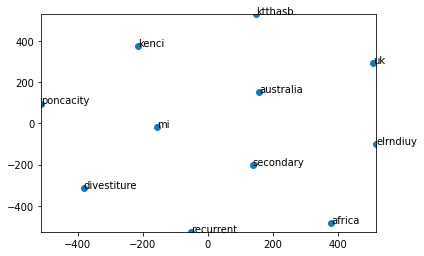

In [ ]:
display_closestwords_tsnescatterplot(model, 'australia', VECTOR_SIZE)

In [ ]:
from sklearn.decomposition import PCA

In [ ]:
def show_word_scatter(model, plot_limit):
    pca = PCA(n_components=2)
    result = pca.fit_transform(model.wv[model.wv.vocab][:plot_limit])

    size = (30,15)
    fig, ax = plt.subplots(figsize=size)

    ax = plt.scatter(result[:, 0], result[:, 1])

    words = list(model.wv.vocab)[:plot_limit]
    for i, word in enumerate(words):
        plt.annotate(word, xy=(result[i, 0], result[i, 1]), fontsize=16)
    plt.show()

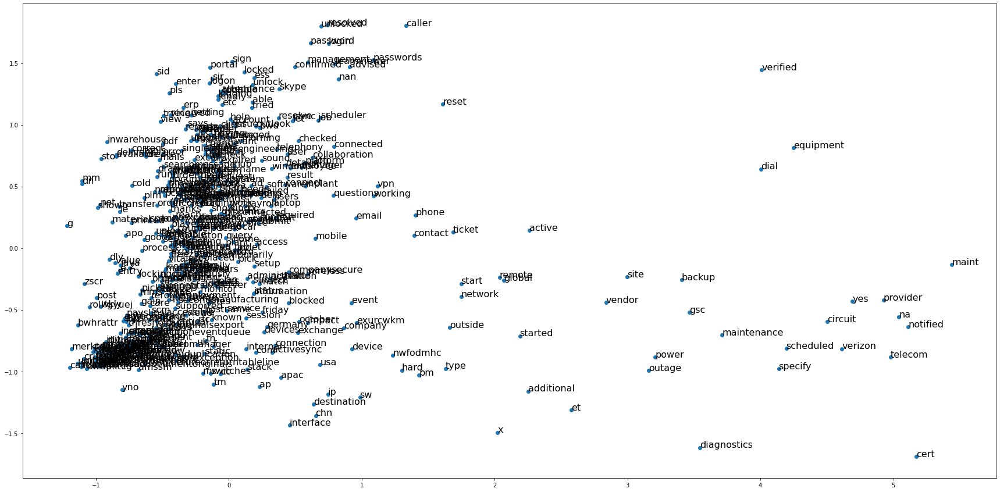

In [ ]:
PLOT_LIMIT = 500
show_word_scatter(model, PLOT_LIMIT)

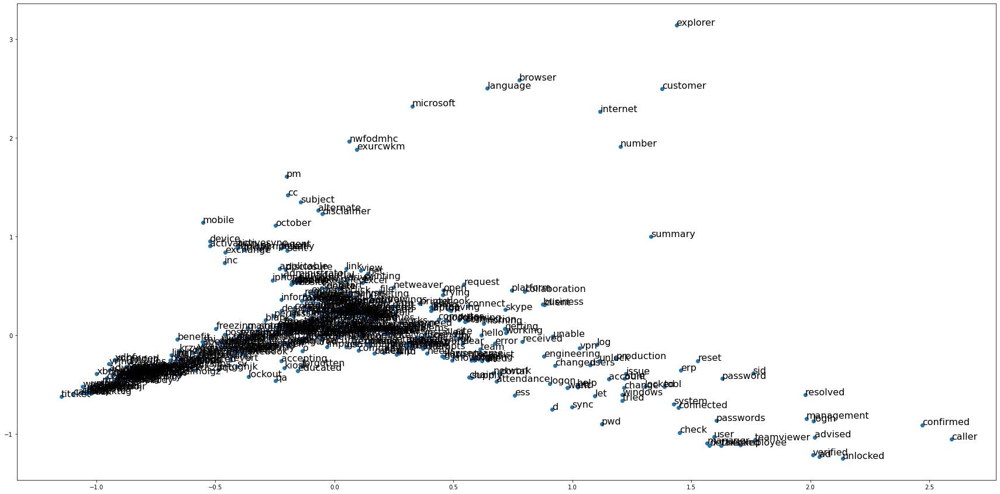

In [ ]:
show_word_scatter(model_0, PLOT_LIMIT)

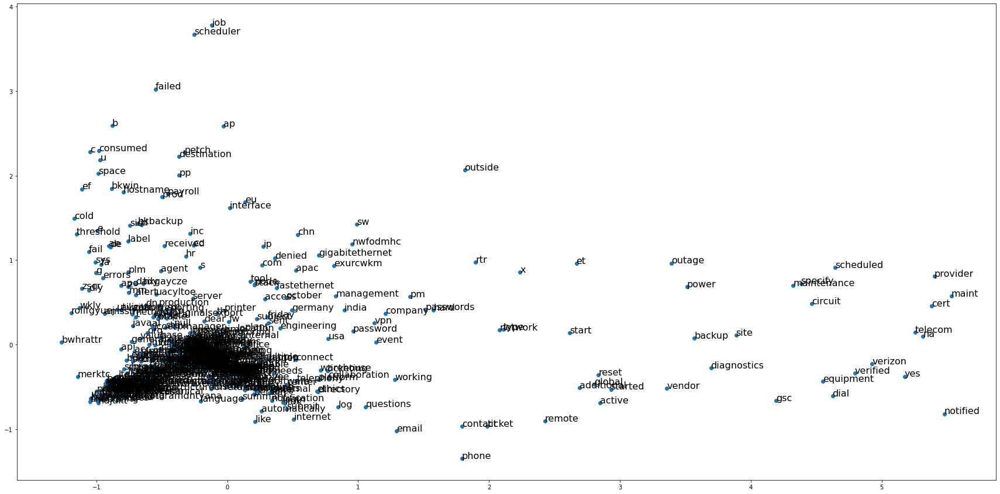

In [ ]:
show_word_scatter(model_non_0, PLOT_LIMIT)

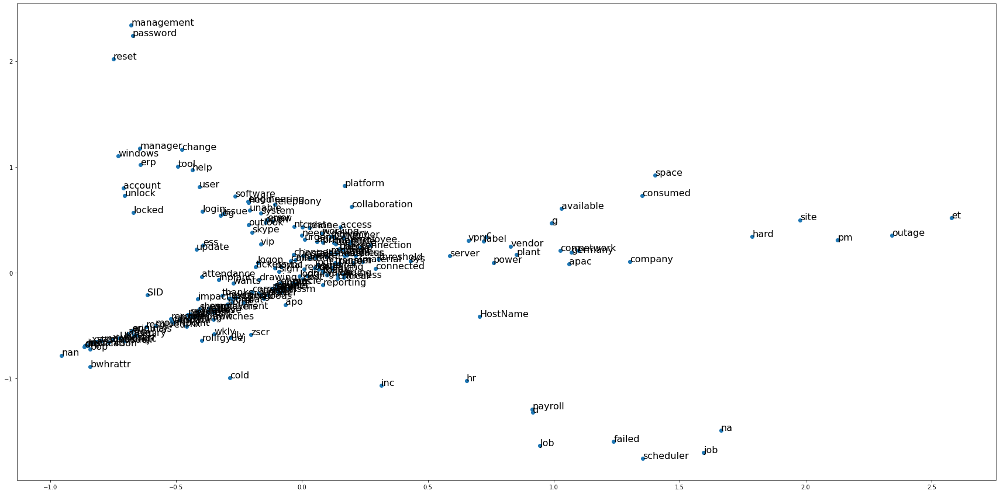

In [ ]:
PLOT_LIMIT_SHORT = 200
show_word_scatter(model_short, PLOT_LIMIT_SHORT)

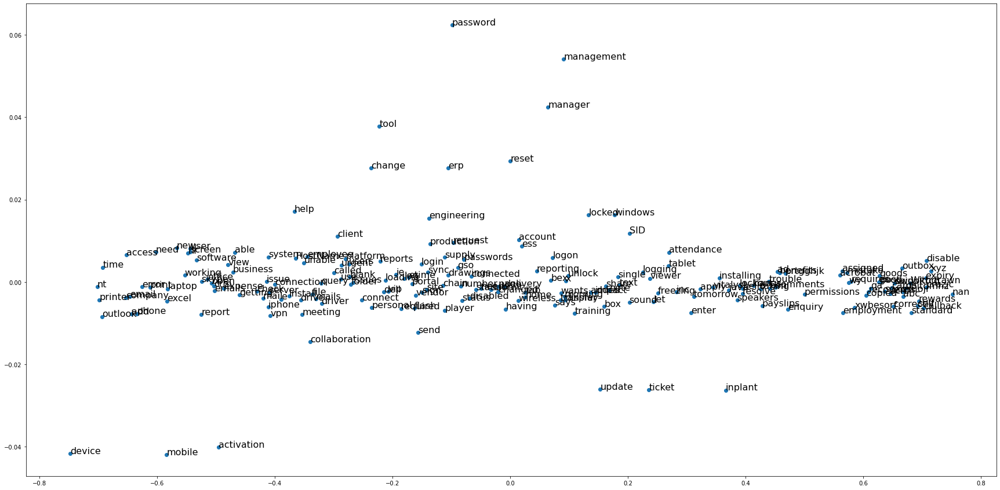

In [ ]:
show_word_scatter(model_0_short, PLOT_LIMIT_SHORT)

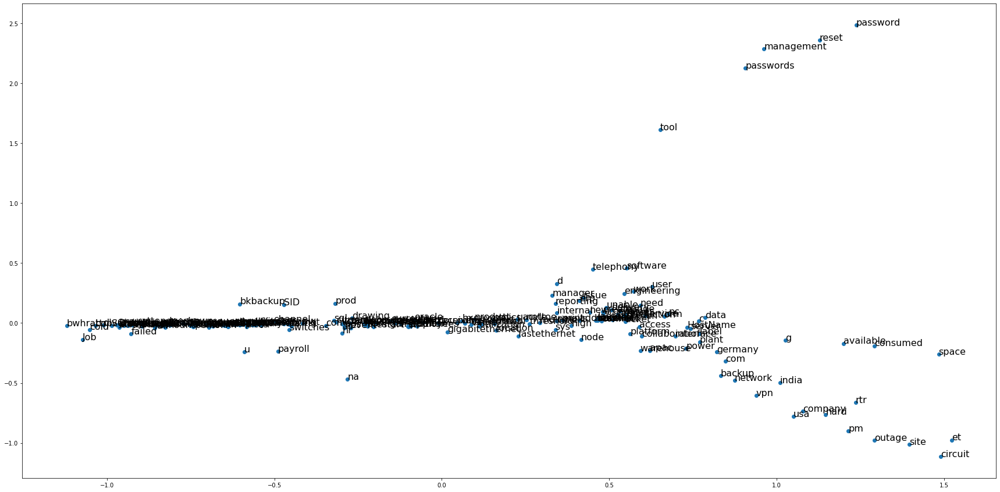

In [ ]:
show_word_scatter(model_non_0_short, PLOT_LIMIT_SHORT)

In [ ]:
from tensorflow.keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences

In [ ]:
max_features = 10000
maxlen = 25
embedding_size = 300

UNKNOWN = "<unknown>"
PADDING = "<padding>"

def tokenize(sentences, max_feat):
  tokenizer = Tokenizer(num_words=max_feat, lower=True, oov_token=UNKNOWN)
  tokenizer.fit_on_texts(sentences)
  tokenizer.word_index[PADDING] = 0
  tokenizer.index_word[0] = PADDING

  sequences = tokenizer.texts_to_sequences(sentences)
  maxlen = max([len(x) for x in sequences])
  return tokenizer, sequences, maxlen

In [ ]:
tokenizer, sequences, maxlen = tokenize(data[X0].astype(str), max_features)
tokenizer_short, sequences_short, maxlen_short = tokenize(data[X1].astype(str), max_features)

tokenizer_0, sequences_0, maxlen_0 = tokenize(data_0[X0].astype(str), max_features)
tokenizer_0_short, sequences_0_short, maxlen_0_short = tokenize(data_0[X1].astype(str), max_features)

tokenizer_non_0, sequences_non_0, maxlen_non_0 = tokenize(data_non_0[X0].astype(str), max_features)
tokenizer_non_0_short, sequences_non_0_short, maxlen_non_0_short = tokenize(data_non_0[X1].astype(str), max_features)

In [ ]:
def pad_sentences(sentences, maxlen):
  return pad_sequences(sentences, maxlen=maxlen, padding='post').tolist()

def reshape_sentences(sentences, maxlen):
  return sentences.reshape(len(sentences), maxlen, 1)

In [ ]:
X = pad_sentences(sequences, maxlen)
X_short = pad_sentences(sequences_short, maxlen)

X_0 = pad_sentences(sequences_0, maxlen)
X_0_short = pad_sentences(sequences_0_short, maxlen)

X_non_0 = pad_sentences(sequences_non_0, maxlen)
X_non_0_short = pad_sentences(sequences_non_0_short, maxlen)

print("-"*50)
print("\nData")
print("\nPadded sequences:\n", X[10])
print("Sequences data type:", type(sequences))
print("Padded sequences data type:", type(X))

print("-"*50)
print("\nData Short Desc")
print("\nPadded sequences:\n", X_short[10])
print("Sequences data type:", type(sequences_short))
print("Padded sequences data type:", type(X_short))

print("-"*50)
print("\nData GRP_0")
print("\nPadded sequences:\n", X_0[10])
print("Sequences data type:", type(sequences_0))
print("Padded sequences data type:", type(X_0))

print("-"*50)
print("\nData GRP_0 Short Desc")
print("\nPadded sequences:\n", X_0_short[10])
print("Sequences data type:", type(sequences_0_short))
print("Padded sequences data type:", type(X_0_short))

print("-"*50)
print("\nData Non GRP_0")
print("\nPadded sequences:\n", X_non_0[10])
print("Sequences data type:", type(sequences_non_0))
print("Padded sequences data type:", type(X_non_0))

print("-"*50)
print("\nData Non GRP_0 Short Desc")
print("\nPadded sequences:\n", X_non_0_short[10])
print("Sequences data type:", type(sequences_non_0_short))
print("Padded sequences data type:", type(X_non_0_short))

--------------------------------------------------

Data

Padded sequences:
 [59, 9, 419, 190, 19, 364, 325, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 

In [ ]:
X = np.asarray(X)
X = reshape_sentences(X, maxlen)

X_short = np.asarray(X_short)
X_short = reshape_sentences(X_short, maxlen)

X_0 = np.asarray(X_0)
X_0 = reshape_sentences(X_0, maxlen)

X_0_short = np.asarray(X_0_short)
X_0_short = reshape_sentences(X_0_short, maxlen)

X_non_0 = np.asarray(X_non_0)
X_non_0 = reshape_sentences(X_non_0, maxlen)

X_non_0_short = np.asarray(X_non_0_short)
X_non_0_short = reshape_sentences(X_non_0_short, maxlen)

print(type(X))
print(X.shape)
print(X_short.shape)
print(X_0.shape)
print(X_0_short.shape)
print(X_non_0.shape)
print(X_non_0_short.shape)

<class 'numpy.ndarray'>
(8492, 1062, 1)
(8492, 1062, 1)
(3969, 1062, 1)
(3969, 1062, 1)
(4523, 1062, 1)
(4523, 1062, 1)


In [ ]:
num_words = len(tokenizer.word_index) + 1
print("All Data, total words= " + str(num_words))

num_words_short = len(tokenizer_short.word_index) + 1
print("All Data Short Desc, total words= " + str(num_words_short))

num_words_0 = len(tokenizer_0.word_index) + 1
print("GRP_0, total words= " + str(num_words_0))

num_words_0_short = len(tokenizer_0_short.word_index) + 1
print("GRP_0 Short Desc, total words= " + str(num_words_0_short))

num_words_non_0 = len(tokenizer_non_0.word_index) + 1
print("Non GRP_0, total words= " + str(num_words_non_0))

num_words_non_0_short = len(tokenizer_non_0_short.word_index) + 1
print("Non GRP_0 Short Desc, total words= " + str(num_words_non_0_short))

All Data, total words= 11058
All Data Short Desc, total words= 4755
GRP_0, total words= 4861
GRP_0 Short Desc, total words= 2018
Non GRP_0, total words= 9001
Non GRP_0 Short Desc, total words= 3855


In [ ]:
EMBEDDING_FILE = f'{PATH}glove.6B.{str(embedding_size)}d.txt'
embeddings = {}
for o in open(EMBEDDING_FILE):
  word = o.split(" ")[0]
  # print(word)
  embd = o.split(" ")[1:]
  embd = np.asarray(embd, dtype='float32')
  # print(embd)
  embeddings[word] = embd

# create a weight matrix for words in training docs
embedding_matrix = np.zeros((num_words, embedding_size))

for word, i in tokenizer.word_index.items():
	embedding_vector = embeddings.get(word)
	if embedding_vector is not None:
		embedding_matrix[i] = embedding_vector

In [ ]:
def scatter_cloud(tokenizer, plot_limit):
  tokens = list(tokenizer.word_index.keys())
  tsne = TSNE(n_components=2, random_state=0)
  target = tsne.fit_transform(embedding_matrix[:plot_limit])
  
  size = (30,15)
  fig, ax = plt.subplots(figsize=size)
  
  ax = sns.scatterplot(target[:, 0], target[:, 1])
  for label, x, y in zip(tokens, target[:, 0], target[:, 1]):
    ax.text(x, y, label, fontsize=16)

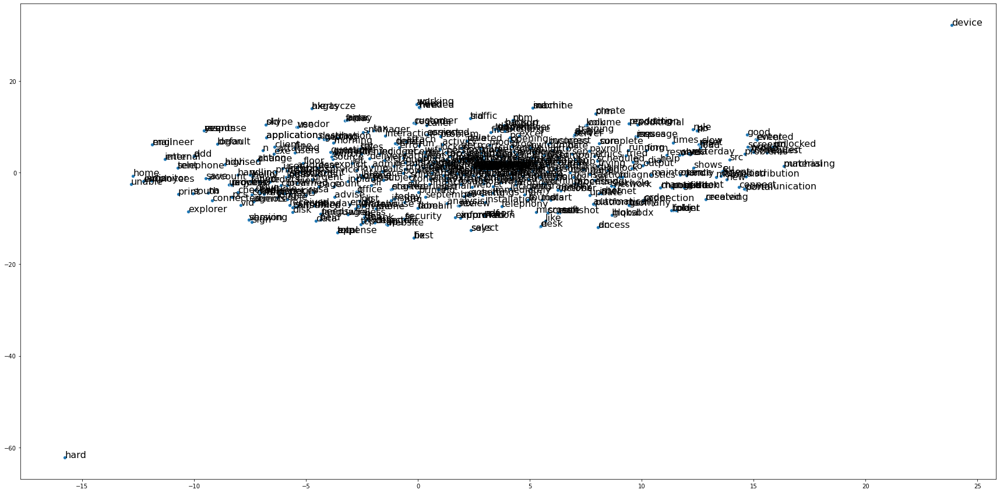

In [ ]:
scatter_cloud(tokenizer, PLOT_LIMIT)

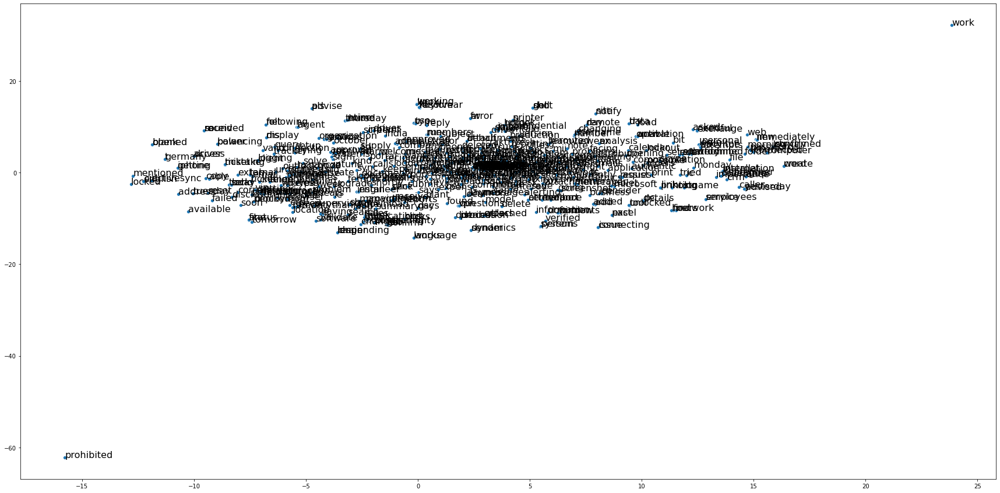

In [ ]:
scatter_cloud(tokenizer_0, PLOT_LIMIT)

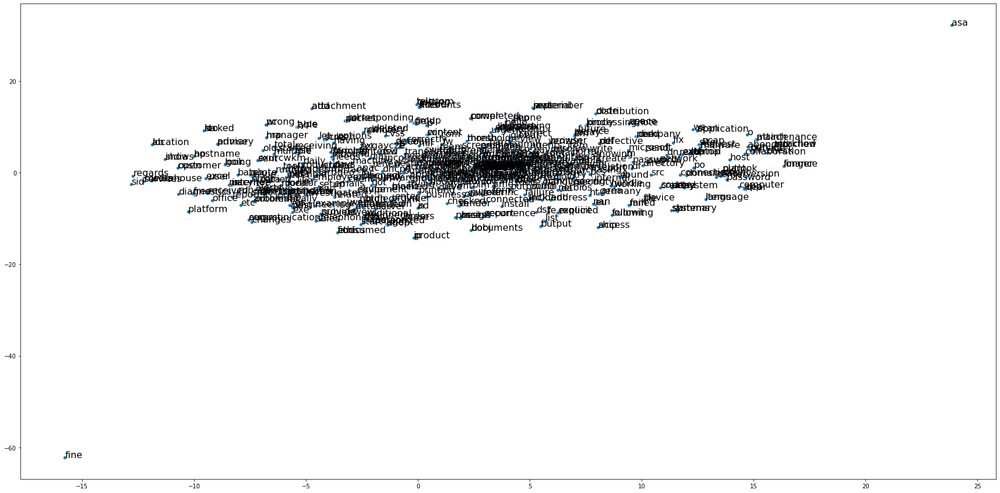

In [ ]:
scatter_cloud(tokenizer_non_0, PLOT_LIMIT)

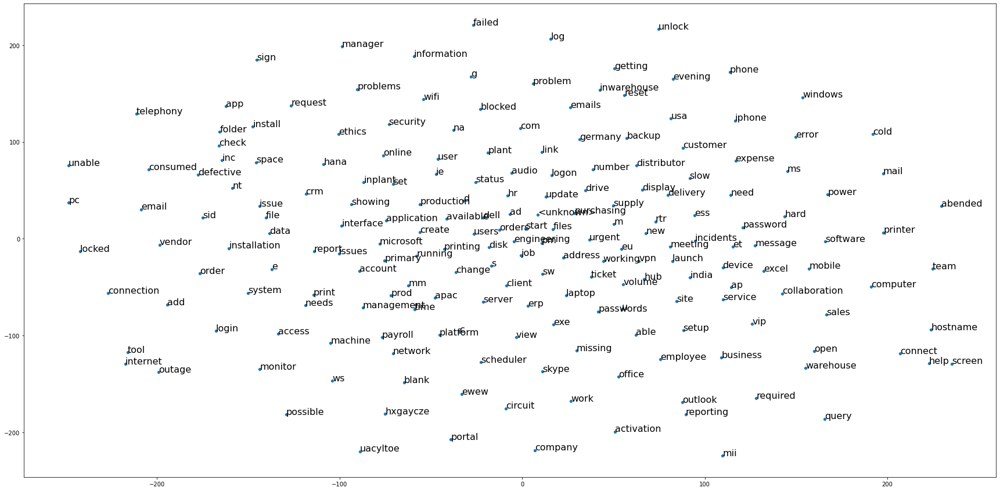

In [ ]:
scatter_cloud(tokenizer_short, PLOT_LIMIT_SHORT)

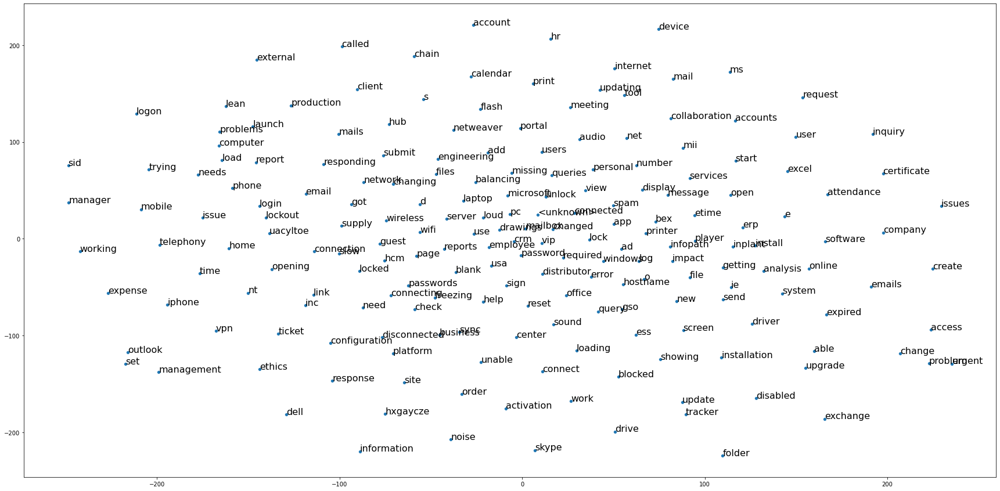

In [ ]:
scatter_cloud(tokenizer_0_short, PLOT_LIMIT_SHORT)

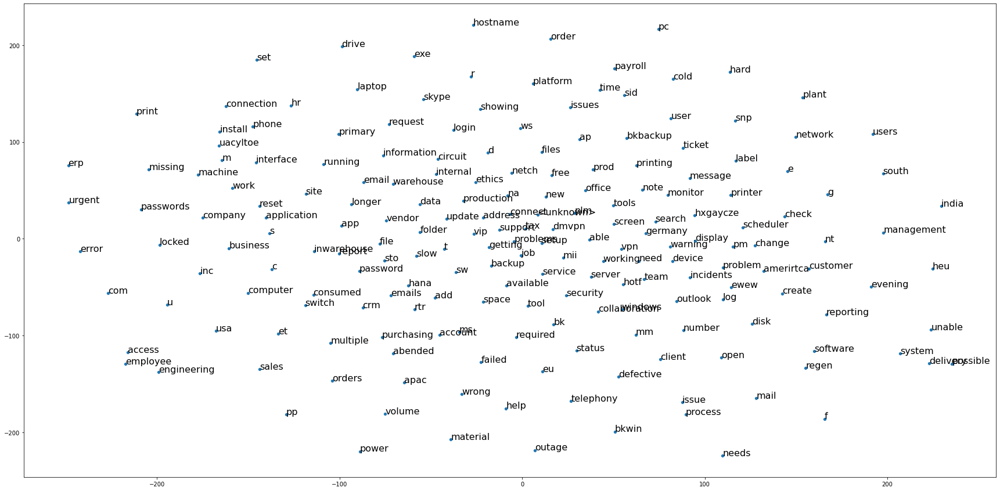

In [ ]:
scatter_cloud(tokenizer_non_0_short, PLOT_LIMIT_SHORT)

Using glove for future purpose will not be useful as cluster couldn't be easily identified and gensim's Word2Vec is better option for creating our own embeddings. Since it is removing all techincal jargons and proper noun which can be best case over here to identify the class

In [ ]:
counted = data.groupby(Y, sort=False).size().reset_index()
counted.to_excel('pivot.xlsx')

# Getting in excel to find which all data needs to be augmented

In [ ]:
# Checking which stopwords are useful in this context

import spacy
import en_core_web_sm
nlp = en_core_web_sm.load()
from spacy.lang.en.stop_words import STOP_WORDS

import csv

# csv_columns = ['STOP_WORDS']
# csv_file = "spacy_stopwords.csv"

# cw = csv.writer(open(csv_file,'w'))
# cw.writerow(csv_columns)

# for row in list(STOP_WORDS):
#   cw.writerow([row for k in csv_columns])

# Data Augmentation using Synonym approach

In [ ]:
# from textblob import TextBlob
# from textblob.translate import NotTranslated
# import math
# import tqdm

import random
import operator

from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences

import spacy
import en_core_web_sm

system_random = random.SystemRandom()

In [ ]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
Unnamed: 0,8492.0,4245.500000,2451.573576,0.0,2122.75,4245.5,6368.25,8491.0
Word Count,8492.0,18.156500,41.855103,1.0,5.00,9.0,19.00,1062.0
Short Word Count,8492.0,4.962789,2.570276,1.0,3.00,4.0,6.00,19.0


In [ ]:
# language = ["es", "de", "fr", "ar", "te", "hi", "ja", "fa", "sq", "bg", "nl", "gu", "ig", "kk", "mt", "ps"]
# def data_augmentation(message, language, aug_range=1):
#   augmented_messages = []
#   if hasattr(message, 'decode'):
#     message = message.decode('utf-8')

#   for index in range(0, aug_range):
#     new_message = ""
#     text = TextBlob(message)

#     try:
#       text = text.translate(to=system_random.choice(language))
#       text = text.translate(to='en')
#     except NotTranslated:
#       pass
#     augmented_messages.append(str(text))

#   return augmented_messages

In [ ]:
# # Although, this method is made earlier, making it more modular
# def make_tokenizer(texts):
#   t = Tokenizer()
#   t.fit_on_texts(texts)
#   return t

# PADDING_FULL = 100
# PADDING_SHORT = 19

# tokenizer_full = make_tokenizer(data[X0])
# tokenizer_short = make_tokenizer(data[X1].astype(str))

# X_full = tokenizer_full.texts_to_sequences(data[X0])
# X_short = tokenizer_full.texts_to_sequences(data[X1].astype(str))

# X_full = pad_sequences(X_full, padding='post', maxlen=PADDING_FULL)
# X_short = pad_sequences(X_short, padding='post', maxlen=PADDING_SHORT)

In [ ]:
# ## Dictionary of word index
# index_word_full = {}
# for word in tokenizer_full.word_index.keys():
#     index_word_full[tokenizer_full.word_index[word]] = word

# index_word_short = {}
# for word in tokenizer_short.word_index.keys():
#     index_word_short[tokenizer_short.word_index[word]] = word

In [ ]:
# ## word list
# words_full = [value for key, value in index_word_full.items()]
# words_short = [value for key, value in index_word_short.items()]

In [ ]:
nlp = en_core_web_sm.load()

def check_lemma(similarities, word):
  r = [d for d in similarities if (nlp(d.text)[0].lemma_ != nlp(word.text)[0].lemma_)]
  return r

def get_word_synonym(word):
  filtered_words = [w for w in word.vocab if (not w.lower_ in STOP_WORDS) and  w.is_lower == word.is_lower and w.prob >= -15]
  similarity = sorted(filtered_words, key=lambda w: word.similarity(w), reverse=True)
  filtered_similarity = check_lemma(similarity[:30], word)
  return filtered_similarity[:3]

def check_oov(word):
  for w in nlp.vocab[word].vocab:
      if not w.is_oov:
        return False

  return True

In [ ]:
synonym_dict_full = {}
for word in words_full:
  if not check_oov(word):
    synonym_dict_full.update({word: tuple([w.lower_ for w in get_word_synonym(nlp.vocab[word])])})
    print(word, " : ", [w.lower_ for w in get_word_synonym(nlp.vocab[word])])

In [ ]:
grp_count = data[Y].value_counts().to_dict()
max_grp_count = max(grp_count.items(), key=operator.itemgetter(1))[1]

In [ ]:
newdf = pd.DataFrame()

for grp, count in grp_count.items():
  count_diff = max_grp_count - count
  multiplication_count = math.ceil(count_diff/count)

3969

In [ ]:
STOP_WORDS.remove('call')

KeyError: ignored

In [ ]:
import nltk

nltk.download('wordnet')

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Unzipping corpora/wordnet.zip.


True

In [ ]:
from nltk.corpus import wordnet 

def get_synonyms(word):
  """
  Get synonyms of a word
  """
  synonyms = set()
    
  for syn in wordnet.synsets(word): 
    for l in syn.lemmas(): 
      synonym = l.name().replace("_", " ").replace("-", " ").lower()
      synonym = "".join([char for char in synonym if char in ' qwertyuiopasdfghjklzxcvbnm'])
      synonyms.add(synonym) 
    
  if word in synonyms:
    synonyms.remove(word)
    
  return list(synonyms)

In [ ]:
def synonym_replacement(words, n):
  words = words.split()
    
  new_words = words.copy()
  random_word_list = list(set([word for word in words if word not in STOP_WORDS]))
  random.shuffle(random_word_list)
  num_replaced = 0
    
  for random_word in random_word_list:
    synonyms = get_synonyms(random_word)
        
    if len(synonyms) >= 1:
      synonym = random.choice(list(synonyms))
      new_words = [synonym if word == random_word else word for word in new_words]
      num_replaced += 1
        
    if num_replaced >= n: #only replace up to n words
      break

  sentence = ' '.join(new_words)
  return sentence

In [ ]:
def random_deletion(words, p):
  words = words.split()
    
  #obviously, if there's only one word, don't delete it
  if len(words) == 1:
    return words

  #randomly delete words with probability p
  new_words = []
  for word in words:
    r = random.uniform(0, 1)
    if r > p:
      new_words.append(word)

  #if you end up deleting all words, just return a random word
  if len(new_words) == 0:
    rand_int = random.randint(0, len(words)-1)
    return [words[rand_int]]

  sentence = ' '.join(new_words)
  return sentence

In [ ]:
def swap_word(new_words):
  random_idx_1 = random.randint(0, len(new_words)-1)
  random_idx_2 = random_idx_1
  counter = 0
    
  while random_idx_2 == random_idx_1:
    random_idx_2 = random.randint(0, len(new_words)-1)
    counter += 1
        
    if counter > 3:
      return new_words
    
  new_words[random_idx_1], new_words[random_idx_2] = new_words[random_idx_2], new_words[random_idx_1] 
  return new_words

def random_swap(words, n):
  words = words.split()
  new_words = words.copy()
    
  for _ in range(n):
    new_words = swap_word(new_words)
        
  sentence = ' '.join(new_words)  
  return sentence

In [ ]:
def random_insertion(words, n):
  words = words.split()
  new_words = words.copy()
  
  for _ in range(n):
    add_word(new_words)
        
  sentence = ' '.join(new_words)
  return sentence

def add_word(new_words):  
  synonyms = []
  counter = 0
    
  while len(synonyms) < 1:
    random_word = new_words[random.randint(0, len(new_words)-1)]
    synonyms = get_synonyms(random_word)
    counter += 1
    if counter >= 10:
      return
        
  random_synonym = synonyms[0]
  random_idx = random.randint(0, len(new_words)-1)
  new_words.insert(random_idx, random_synonym)

In [ ]:
sentence = data[X1][0]
synonym_replaced = synonym_replacement(sentence, 16)
print(sentence)
print(synonym_replaced)

login issue
login put out


'affirm substance abuser item employee handler chink substance abuser advertisement readjust word propose substance abuser login determine company reassert capable login supply settle'